Step1: for this assignment you can provide your own data. The data must be pulled/scraped from online resources (as covered in other courses) to obtain full credit of this step. For example, you can scrape tweeter data or Kijiji data etc.

In [2]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler

### Step 1

In [66]:
df = pd.read_csv('https://raw.githubusercontent.com/afscomercial/weather_clustering/refs/heads/main/data.csv')
df.head()

,dt,dt_iso,timezone,city_name,lat,lon,temp,visibility,dew_point,feels_like,...,wind_gust,rain_1h,rain_3h,snow_1h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,1548892800,2019-01-31 00:00:00 +0000 UTC,-18000,Toronto,43.653226,-79.383184,-17.57,1207.0,-21.60,-24.57,...,20.06,NaN,NaN,NaN,NaN,40,600,Snow,light snow,13n
1,1548896400,2019-01-31 01:00:00 +0000 UTC,-18000,Toronto,43.653226,-79.383184,-18.42,402.0,-22.58,-25.42,...,19.00,NaN,NaN,NaN,NaN,40,600,Snow,light snow,13n
2,1548900000,2019-01-31 02:00:00 +0000 UTC,-18000,Toronto,43.653226,-79.383184,-19.24,3218.0,-23.07,-26.24,...,20.60,NaN,NaN,NaN,NaN,100,600,Snow,light snow,13n
3,1548903600,2019-01-31 03:00:00 +0000 UTC,-18000,Toronto,43.653226,-79.383184,-19.40,10000.0,-23.83,-26.40,...,18.00,NaN,NaN,NaN,NaN,20,801,Clouds,few clouds,02n
4,1548907200,2019-01-31 04:00:00 +0000 UTC,-18000,Toronto,43.653226,-79.383184,-19.71,10000.0,-24.44,-26.71,...,17.00,NaN,NaN,NaN,NaN,0,800,Clear,sky is clear,01n


In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44256 entries, 0 to 44255
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   dt                   44256 non-null  int64  
 1   dt_iso               44256 non-null  object 
 2   timezone             44256 non-null  int64  
 3   city_name            44256 non-null  object 
 4   lat                  44256 non-null  float64
 5   lon                  44256 non-null  float64
 6   temp                 44256 non-null  float64
 7   visibility           35094 non-null  float64
 8   dew_point            44256 non-null  float64
 9   feels_like           44256 non-null  float64
 10  temp_min             44256 non-null  float64
 11  temp_max             44256 non-null  float64
 12  pressure             44256 non-null  int64  
 13  sea_level            0 non-null      float64
 14  grnd_level           0 non-null      float64
 15  humidity             44256 non-null 

### Step 2

Data Cleaning

In [68]:
#Dropping Irrelevant Columns
df.drop(columns=['sea_level', 'grnd_level'], inplace=True)
# Drop timezone columns
df.drop(columns=['timezone'], inplace=True)
# Drop location columns as all the data is for the same location
df.drop(columns=['city_name', 'lat', 'lon', 'weather_id', 'weather_icon'], inplace=True)

In [69]:
# Count missing values per column
missing_values = df.isnull().sum()
print(missing_values)

dt                         0
dt_iso                     0
temp                       0
visibility              9162
dew_point                  0
feels_like                 0
temp_min                   0
temp_max                   0
pressure                   0
humidity                   0
wind_speed                 0
wind_deg                   0
wind_gust              23716
rain_1h                36961
rain_3h                43924
snow_1h                42993
snow_3h                44206
clouds_all                 0
weather_main               0
weather_description        0
dtype: int64


In [70]:
# Fill rain and snow columns with 0 since it likely means no rain/snow occurred.
df['rain_1h'] = df['rain_1h'].fillna(0)
df['rain_3h'] = df['rain_3h'].fillna(0)
df['snow_1h'] = df['snow_1h'].fillna(0)
df['snow_3h'] = df['snow_3h'].fillna(0)

# For wind gust, fill with 0 assuming no gusts if no data was recorded
df['wind_gust'] = df['wind_gust'].fillna(0)

# For visibility fill with median 
df['visibility'] = df['visibility'].fillna(df['visibility'].median())


Validation

In [71]:
# wind speed should not be negative, and humidity should range between 0 and 100.
assert df['humidity'].between(0, 100).all(), "Invalid humidity values"


In [72]:
assert (df['wind_speed'] >= 0).all(), "Negative wind speed values"

In [73]:
# Data Consistency: Ensure that related columns are consistent.the temp_min column should always be less than or equal to temp_max.
df = df[df['temp_min'] <= df['temp_max']]

Feature Enginneering

In [74]:
df['dt_iso'] = pd.to_datetime(df['dt_iso'], format='%Y-%m-%d %H:%M:%S +0000 UTC')  # Specify format
df['year'] = df['dt_iso'].dt.year
df['month'] = df['dt_iso'].dt.month
df['day'] = df['dt_iso'].dt.day
df['hour'] = df['dt_iso'].dt.hour

In [75]:
# Drop the 'dt' and 'weather_description', 'weather_type', 'dt-iso' columns
df.drop(columns=['dt', 'weather_description', 'dt_iso', 'weather_main'], inplace=True)

Normalization

In [76]:
# List of numerical columns to normalize
num_cols = [
    'temp', 'visibility', 'dew_point', 'feels_like',
    'temp_min', 'temp_max', 'pressure', 'humidity',
    'wind_speed', 'wind_deg', 'wind_gust', 
    'rain_1h', 'rain_3h', 'snow_1h', 'snow_3h',
    'clouds_all', 'year', 'month', 'day', 'hour'
]

# Initialize the StandardScaler
scaler = StandardScaler()

# Standardize the numerical features
df[num_cols] = scaler.fit_transform(df[num_cols])

In [77]:
# export to csv
df.to_csv('clean_data.csv', index=False)

### Step 3

Step 4 was worked in a separate notebook (step-3.ipynb) due the limitations of 100MB per file in github

### Step 4

Step 4 was worked in a separate notebook (step-4.ipynb) due the limitations of 100MB per file in github

### Step 5

No encoding required all the categorical columns were removed

### Step 6

# Boxplots:

In [13]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

df_raw = pd.read_csv('data.csv')

def plot_all_boxplots_plotly(df_raw, num_cols):
    fig = make_subplots(rows=len(num_cols), cols=1, subplot_titles=num_cols)
    for i, col in enumerate(num_cols):
        fig.add_trace(go.Box(y=df[col], name=col), row=i+1, col=1)

    fig.update_layout(
        height=300 * len(num_cols),  
        showlegend=False,
        title="Boxplots for Selected Numerical Columns"
    )

    fig.show()


In [14]:
plot_all_boxplots_plotly(df_raw,num_cols)

# IQR:

In [15]:
def iqr(df_raw, num_cols):
    iqr_dict = {}
    for col in num_cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        iqr_dict[col] = IQR 
    
    return iqr_dict


In [16]:
iqr_values = iqr(df_raw, num_cols)
for col, qr in iqr_values.items():
    print(f"IQR for {col}: {qr:.2f}")


IQR for temp: 1.68
IQR for visibility: 0.00
IQR for dew_point: 1.58
IQR for feels_like: 1.71
IQR for temp_min: 1.65
IQR for temp_max: 1.67
IQR for pressure: 1.24
IQR for humidity: 1.45
IQR for wind_speed: 1.38
IQR for wind_deg: 1.98
IQR for wind_gust: 1.50
IQR for rain_1h: 0.00
IQR for rain_3h: 0.00
IQR for snow_1h: 0.00
IQR for snow_3h: 0.00
IQR for clouds_all: 2.27
IQR for year: 1.42
IQR for month: 1.76
IQR for day: 1.70
IQR for hour: 1.73


### Step 7

description of the columns

city_name City name
lat Geographical coordinates of the location (latitude)
lon Geographical coordinates of the location (longitude)
main
main.temp Temperature
main.temp_min Minimum temperature at the moment. This is deviation from temperature that is possible for large cities and megalopolises geographically expanded (use these parameter optionally).
main.temp_max Maximum temperature at the moment. This is deviation from temperature that is possible for large cities and megalopolises geographically expanded (use these parameter optionally).
main.feels_like This temperature parameter accounts for the human perception of weather 
main.pressure Atmospheric pressure (on the sea level), hPa
main.humidity Humidity, %
main.dew_point Atmospheric temperature (varying according to pressure and humidity) below which water droplets begin to condense and dew can form. Units – default: kelvin
wind
wind.speed Wind speed. Units – default: meter/sec
wind.deg Wind direction, degrees (meteorological)
wind.gust Wind gust. Units – default: meter/sec
clouds
clouds.all Cloudiness, %
rain
rain.1h Rain volume for the last hour, mm
rain.3h Rain volume for the last 3 hours, mm
snow
snow.1h Snow volume for the last hour, mm (in liquid state)
snow.3h Snow volume for the last 3 hours, mm (in liquid state)
weather
weather.id Weather condition id
weather.main Group of weather parameters (Rain, Snow, Extreme etc.)
weather.description Weather condition within the group. 
weather.icon Weather icon
visibility Average visibility, metres. The maximum value of the visibility is 10km
dt Time of data calculation, unix, UTC
dt_isoDate and time in UTC format
timezone Shift in seconds from UTC

### Quantile-based Flooring and Capping

In [52]:
numerical_df = df.select_dtypes(include=['int64', 'float64'])

In [53]:
# Define lower and upper quantiles
lower_quantile = df.quantile(0.01)
upper_quantile = df.quantile(0.99)

# Apply flooring and capping
df_floored_capped = df.clip(lower=lower_quantile, upper=upper_quantile, axis=1)

In [56]:
# Skewness values before flooring and capping
for column in num_cols:
    print(f"Column: {column} Skew: {df[column].skew().round(2)}")

Column: temp Skew: -0.05
Column: visibility Skew: -2.61
Column: dew_point Skew: -0.14
Column: feels_like Skew: -0.12
Column: temp_min Skew: -0.06
Column: temp_max Skew: -0.03
Column: pressure Skew: -0.02
Column: humidity Skew: -0.44
Column: wind_speed Skew: 0.96
Column: wind_deg Skew: -0.3
Column: wind_gust Skew: 1.17
Column: rain_1h Skew: 11.11
Column: rain_3h Skew: 41.61
Column: snow_1h Skew: 30.07
Column: snow_3h Skew: 67.88
Column: clouds_all Skew: -0.29
Column: year Skew: -0.02
Column: month Skew: -0.02
Column: day Skew: 0.01
Column: hour Skew: 0.0


In [61]:
# Skewness values before flooring and capping
for column in num_cols:
    print(f"Column: {column} Skew: {df_floored_capped[column].skew().round(2)}")

Column: temp Skew: -0.02
Column: visibility Skew: -2.58
Column: dew_point Skew: -0.09
Column: feels_like Skew: -0.1
Column: temp_min Skew: -0.04
Column: temp_max Skew: -0.01
Column: pressure Skew: 0.02
Column: humidity Skew: -0.41
Column: wind_speed Skew: 0.84
Column: wind_deg Skew: -0.31
Column: wind_gust Skew: 1.11
Column: rain_1h Skew: 4.69
Column: rain_3h Skew: 0.0
Column: snow_1h Skew: 6.92
Column: snow_3h Skew: 0.0
Column: clouds_all Skew: -0.29
Column: year Skew: -0.02
Column: month Skew: -0.02
Column: day Skew: 0.01
Column: hour Skew: 0.0


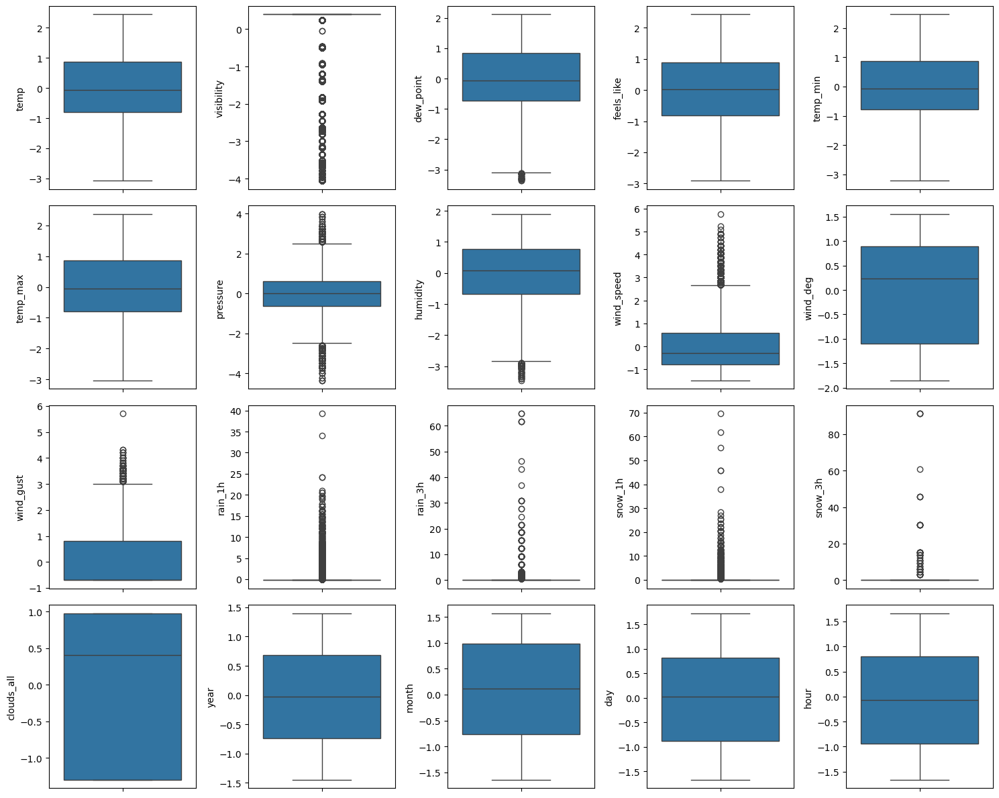

In [54]:
import seaborn as sns
import matplotlib.pyplot as plt

# assuming 'df' is your DataFrame
n_cols = 5  # number of columns in each row
n_rows = (len(num_cols) + n_cols - 1) // n_cols  # calculate number of rows

fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 3*n_rows))

for i, col in enumerate(num_cols):
    row = i // n_cols
    col_idx = i % n_cols
    sns.boxplot(df[col], ax=axs[row, col_idx])

# remove any unused subplots
for i in range(len(num_cols), n_rows*n_cols):
    row = i // n_cols
    col_idx = i % n_cols
    axs[row, col_idx].axis('off')

plt.tight_layout()
plt.show()

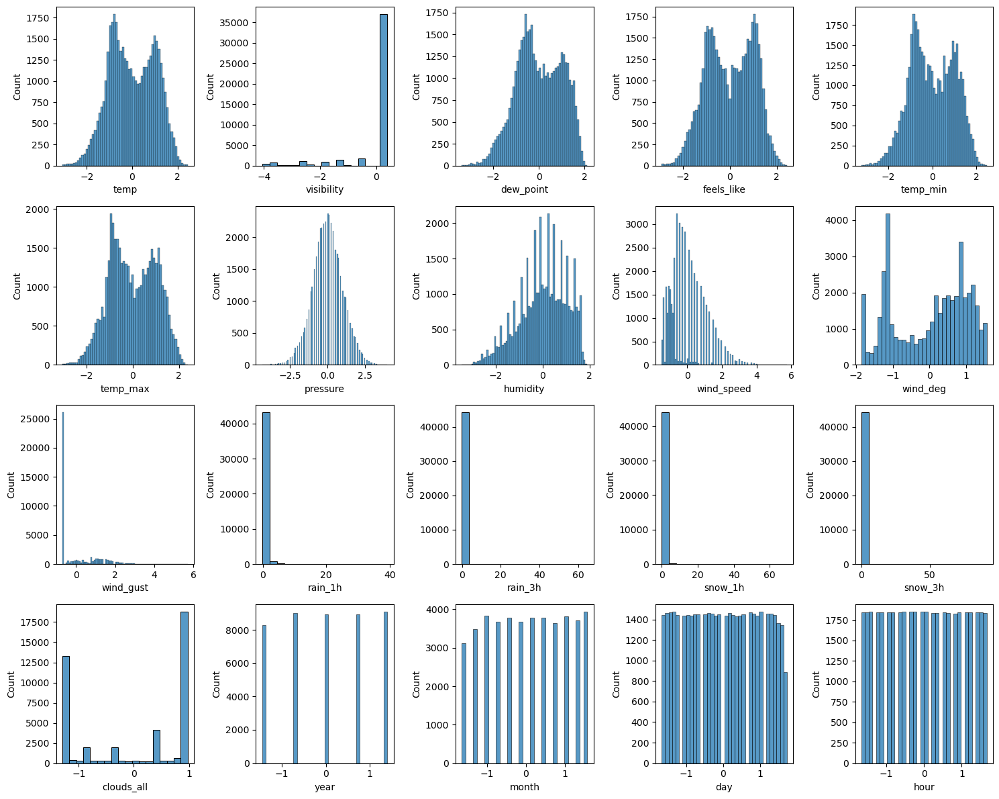

In [55]:
n_cols = 5  # number of columns in each row
n_rows = (len(num_cols) + n_cols - 1) // n_cols  # calculate number of rows

fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 3*n_rows))

for i, col in enumerate(num_cols):
    row = i // n_cols
    col_idx = i % n_cols
    sns.histplot(df[col], ax=axs[row, col_idx])

# remove any unused subplots
for i in range(len(num_cols), n_rows*n_cols):
    row = i // n_cols
    col_idx = i % n_cols
    axs[row, col_idx].axis('off')

plt.tight_layout()
plt.show()

### Trimming

In [57]:
# Define a threshold for trimming (1st and 99th percentiles)
threshold_low = numerical_df.quantile(0.01)
threshold_high = numerical_df.quantile(0.99)

# Trim the DataFrame
df_trimmed = numerical_df[~((numerical_df < threshold_low) | (numerical_df > threshold_high)).any(axis=1)]

In [62]:
# Skewness values after trimming
for column in num_cols:
    print(f"Column: {column} Skew: {df_trimmed[column].skew().round(2)}")

Column: temp Skew: -0.02
Column: visibility Skew: -3.02
Column: dew_point Skew: -0.06
Column: feels_like Skew: -0.12
Column: temp_min Skew: -0.02
Column: temp_max Skew: -0.0
Column: pressure Skew: 0.02
Column: humidity Skew: -0.38
Column: wind_speed Skew: 0.73
Column: wind_deg Skew: -0.32
Column: wind_gust Skew: 1.11
Column: rain_1h Skew: 4.95
Column: rain_3h Skew: 0.0
Column: snow_1h Skew: 8.94
Column: snow_3h Skew: 0.0
Column: clouds_all Skew: -0.26
Column: year Skew: -0.04
Column: month Skew: -0.06
Column: day Skew: 0.01
Column: hour Skew: 0.04


### Log transformation

In [58]:
(numerical_df < 0).sum()

temp          22843
visibility     7337
dew_point     22846
feels_like    21860
temp_min      22874
temp_max      22873
pressure      23413
humidity      20391
wind_speed    25230
wind_deg      18903
wind_gust     29287
rain_1h       37588
rain_3h       43924
snow_1h       42993
snow_3h       44206
clouds_all    19430
year          26229
month         21575
day           21788
hour          22167
dtype: int64

In [59]:
# Define a signed log transformation function
def signed_log_transform(x):
    return np.sign(x) * np.log1p(abs(x))  # Preserve the sign and apply log(1 + abs(x))

# Apply the signed log transformation to all numeric columns in the DataFrame
df_log_transformed = numerical_df.applymap(signed_log_transform)

/var/folders/8b/gvyhprgn3t764q19dkq1gt2c0000gp/T/ipykernel_23075/1596021141.py:6: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



In [63]:
# Skewness values after log transformation
for column in num_cols:
    print(f"Column: {column} Skew: {df_log_transformed[column].skew().round(2)}")

Column: temp Skew: 0.02
Column: visibility Skew: -2.17
Column: dew_point Skew: -0.01
Column: feels_like Skew: -0.05
Column: temp_min Skew: 0.02
Column: temp_max Skew: 0.02
Column: pressure Skew: 0.01
Column: humidity Skew: -0.24
Column: wind_speed Skew: 0.52
Column: wind_deg Skew: -0.27
Column: wind_gust Skew: 0.87
Column: rain_1h Skew: 4.01
Column: rain_3h Skew: 17.59
Column: snow_1h Skew: 7.89
Column: snow_3h Skew: 34.27
Column: clouds_all Skew: -0.27
Column: year Skew: -0.01
Column: month Skew: -0.01
Column: day Skew: 0.0
Column: hour Skew: 0.0


### Step 8

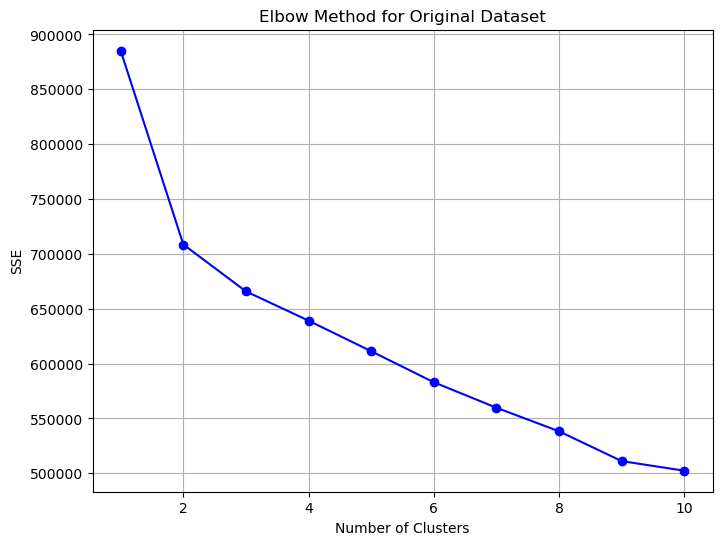

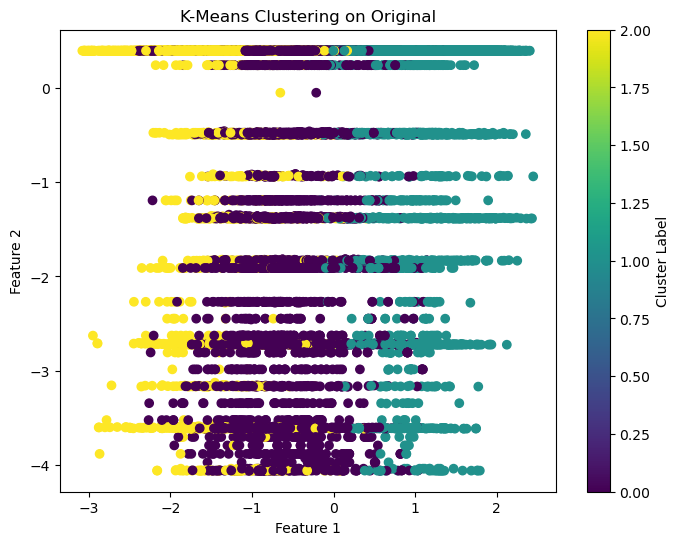

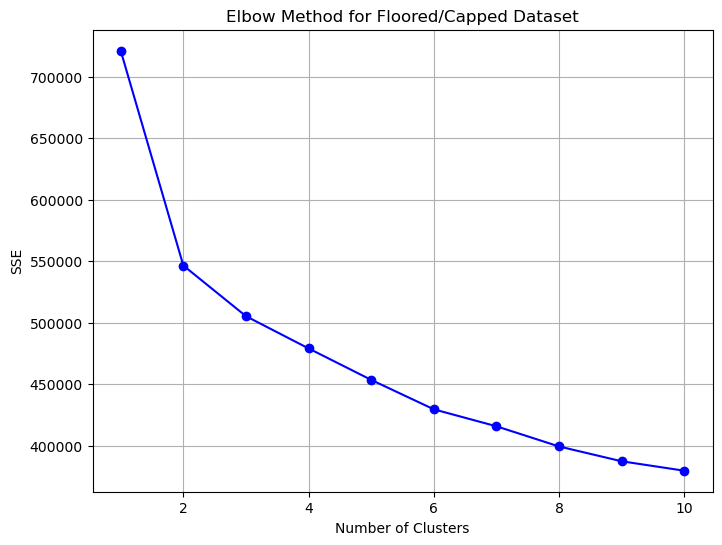

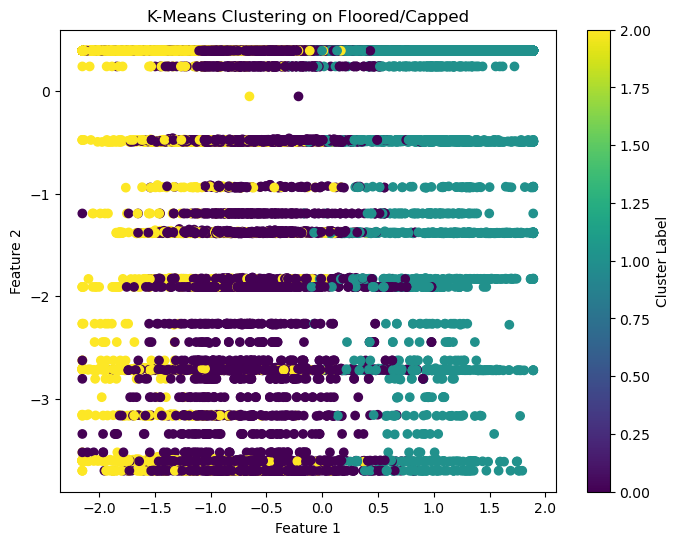

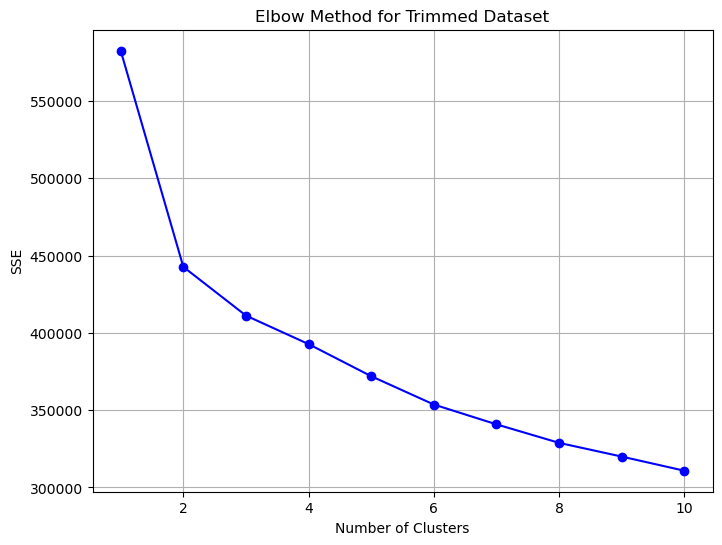

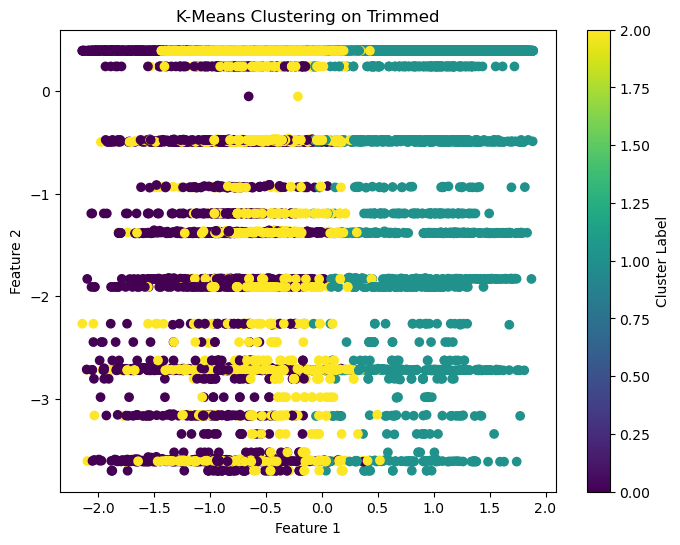

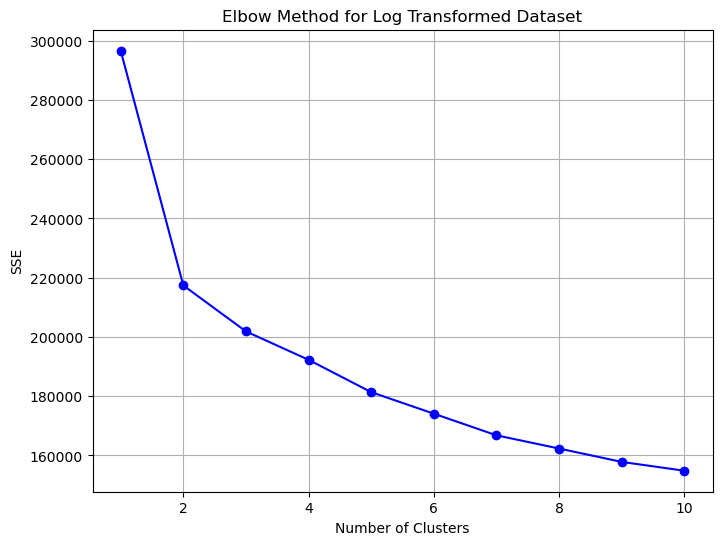

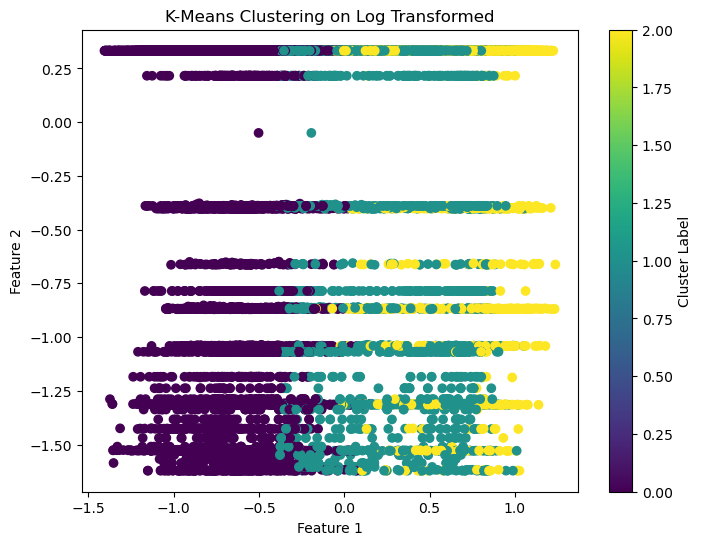

Original Dataset: Optimal number of clusters based on AIC: 10
Original Dataset: Optimal number of clusters based on BIC: 10


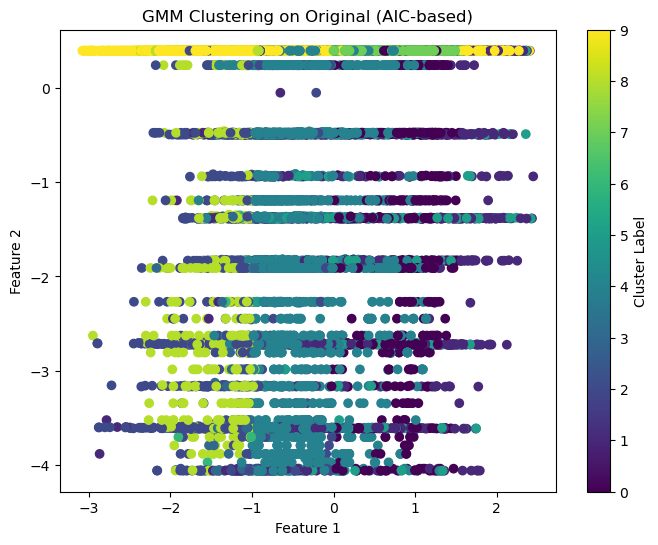

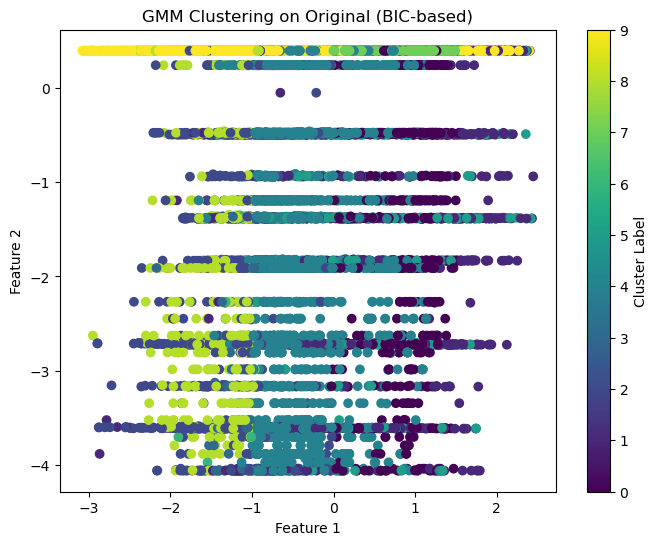

Floored/Capped Dataset: Optimal number of clusters based on AIC: 10
Floored/Capped Dataset: Optimal number of clusters based on BIC: 10


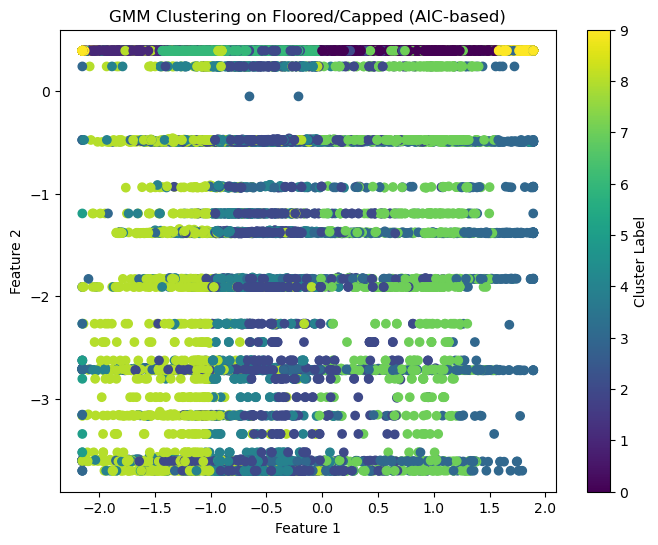

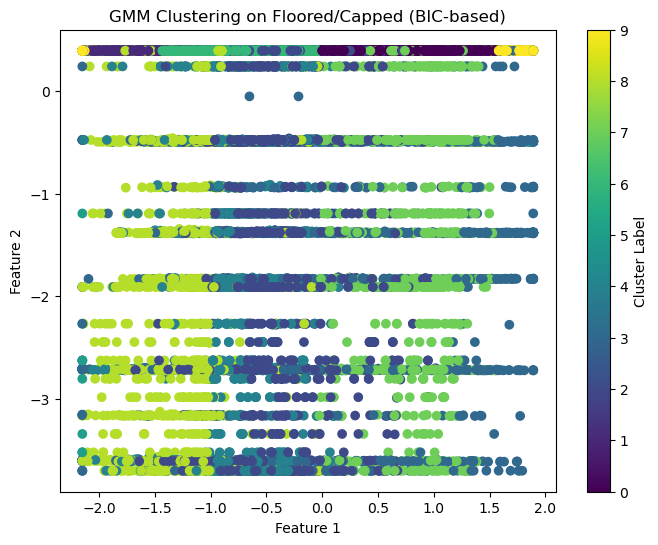

Trimmed Dataset: Optimal number of clusters based on AIC: 8
Trimmed Dataset: Optimal number of clusters based on BIC: 8


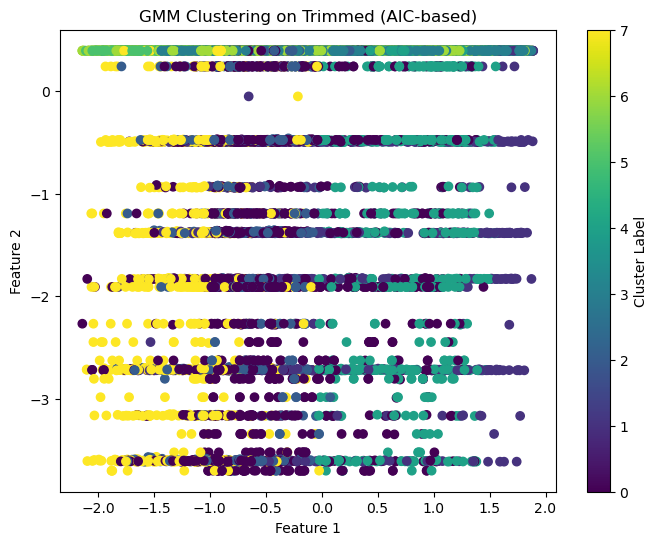

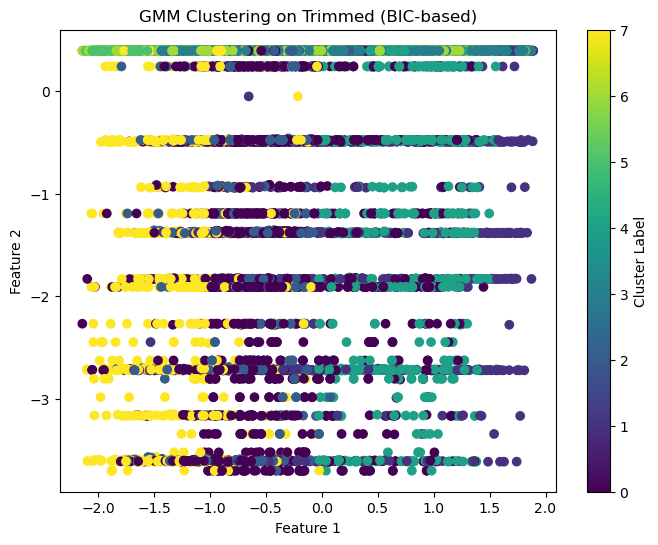

Log Transformed Dataset: Optimal number of clusters based on AIC: 9
Log Transformed Dataset: Optimal number of clusters based on BIC: 9


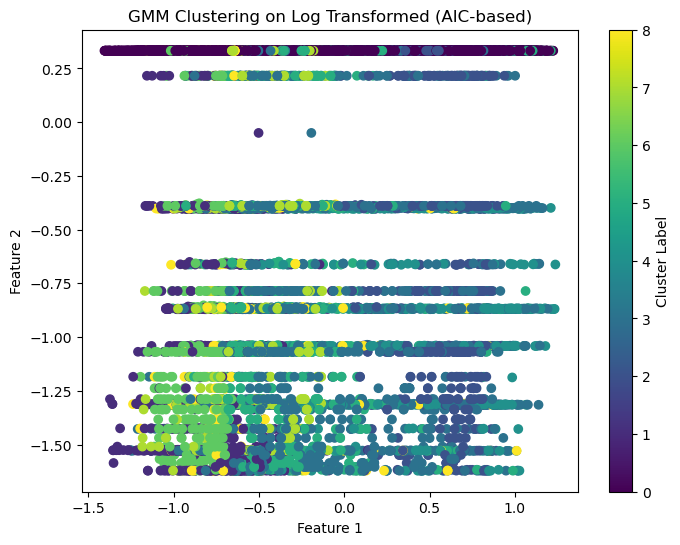

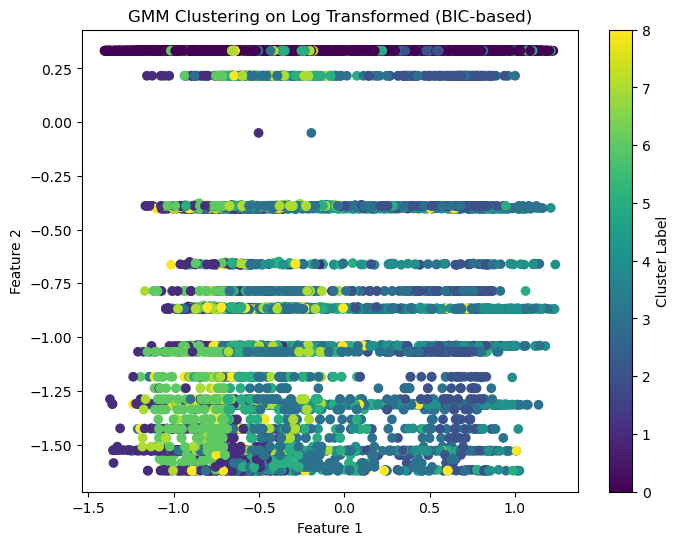

In [64]:
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans

# Define the datasets for clustering
datasets = {
    'Original': df,
    'Floored/Capped': df_floored_capped,
    'Trimmed': df_trimmed,
    'Log Transformed': df_log_transformed
}

# Optimal Cluster Finder and Clustering for K-Means
for name, data in datasets.items():
    if data.empty:  # Skip empty datasets
        continue
    
    # Determine the optimal number of clusters using the Elbow method
    sse = []  # Sum of squared errors for each k
    k_range = range(1, 11)  # Testing cluster numbers from 1 to 10
    for k in k_range:
        kmeans = KMeans(n_clusters=k, random_state=0)
        kmeans.fit(data)
        sse.append(kmeans.inertia_)
    
    # Plot the Elbow graph
    plt.figure(figsize=(8, 6))
    plt.plot(k_range, sse, 'bo-')
    plt.xlabel('Number of Clusters')
    plt.ylabel('SSE')
    plt.title(f'Elbow Method for {name} Dataset')
    plt.grid()
    plt.show()
    
    # Choose the optimal number of clusters based on the Elbow method (for simplicity, we'll use 3 clusters)
    optimal_k = 3
    kmeans = KMeans(n_clusters=optimal_k, random_state=42)
    labels_kmeans = kmeans.fit_predict(data)

    # Plot KMeans clustering results
    plt.figure(figsize=(8, 6))
    plt.scatter(data.iloc[:, 0], data.iloc[:, 1], c=labels_kmeans, cmap='viridis', marker='o')
    plt.title(f'K-Means Clustering on {name}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.colorbar(label='Cluster Label')
    plt.show()

# Optimal Cluster Finder and Clustering for GMM
for name, data in datasets.items():
    if data.empty:  # Skip empty datasets
        continue
    
    # Define range of components (clusters) to test
    n_components = range(1, 11)
    
    # Fit GMM models with different number of clusters and calculate AIC/BIC
    aic_values = []
    bic_values = []
    for n in n_components:
        gmm = GaussianMixture(n_components=n, random_state=0)
        gmm.fit(data)
        aic_values.append(gmm.aic(data))
        bic_values.append(gmm.bic(data))
    
    # Find the optimal number of clusters based on the minimum AIC and BIC
    optimal_aic_clusters = n_components[aic_values.index(min(aic_values))]
    optimal_bic_clusters = n_components[bic_values.index(min(bic_values))]
    
    # Print the optimal number of clusters
    print(f'{name} Dataset: Optimal number of clusters based on AIC: {optimal_aic_clusters}')
    print(f'{name} Dataset: Optimal number of clusters based on BIC: {optimal_bic_clusters}')
    
    # Fit GMM using the optimal number of clusters (AIC-based)
    gmm_optimal = GaussianMixture(n_components=optimal_aic_clusters, random_state=0)
    gmm_optimal.fit(data)
    cluster_labels_aic = gmm_optimal.predict(data)

    # Fit GMM using the optimal number of clusters (BIC-based)
    gmm_optimal_bic = GaussianMixture(n_components=optimal_bic_clusters, random_state=0)
    gmm_optimal_bic.fit(data)
    cluster_labels_bic = gmm_optimal_bic.predict(data)

    # Plot the clustered data for GMM (AIC-based)
    plt.figure(figsize=(8, 6))
    plt.scatter(data.iloc[:, 0], data.iloc[:, 1], c=cluster_labels_aic, cmap='viridis', marker='o')
    plt.title(f'GMM Clustering on {name} (AIC-based)')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.colorbar(label='Cluster Label')
    plt.show()
    
    # Plot the clustered data for GMM (BIC-based)
    plt.figure(figsize=(8, 6))
    plt.scatter(data.iloc[:, 0], data.iloc[:, 1], c=cluster_labels_bic, cmap='viridis', marker='o')
    plt.title(f'GMM Clustering on {name} (BIC-based)')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.colorbar(label='Cluster Label')
    plt.show()
